# Inspection for 10-12-2018 Data

The samping rate for EEG is 300 Hz, while the one for accelerometer data is **30 Hz** !

### Description
This notebook explores the EEG and accelerometer data collected on October 12, 2018 where the subject was performing naturalistic tasks, as marked in the events column of the data.

## Import Data

In [1]:
import numpy as np
import pandas as pd
import altair as alt
alt.renderers.enable('notebook') # run this line if using Jupyter Notebook (not Lab)
alt.data_transformers.enable('default', max_rows=None)

DataTransformerRegistry.enable('default')

In [2]:
df = pd.read_csv("data/2018-10-12-preston_walk_raw.csv", ",", skiprows=15)
df.head()

,Time,LE,F4,C4,PO8,PO7,C3,F3,Trigger,Time_Offset,ADC_Status,ADC_Sequence,Event,Comments
0,0.0033,3642.0,-2536.8,3530.1,2459.4,296.7,3454.5,-1103.4,0,6,0,207,0,Start Data Acquisition
1,0.0067,3635.7,-2526.3,3531.0,2451.9,299.7,3459.6,-1098.9,0,12,0,208,0,NaN
2,0.0100,3632.7,-2535.9,3528.6,2441.4,302.1,3454.8,-1103.4,0,18,0,209,0,NaN
3,0.0133,3626.7,-2535.3,3524.1,2450.1,297.9,3455.1,-1097.1,0,24,0,210,0,NaN
4,0.0167,3626.4,-2527.8,3539.4,2469.0,289.8,3452.7,-1089.9,0,30,0,211,0,NaN


In [3]:
df.columns

Index(['Time', 'LE', 'F4', 'C4', 'PO8', 'PO7', 'C3', 'F3', 'Trigger',
       'Time_Offset', 'ADC_Status', 'ADC_Sequence', 'Event', 'Comments'],
      dtype='object')

In [4]:
# Reformat the dataframe for easy use in Altair later
df = df.melt(id_vars=['Time', 'Trigger', 'Time_Offset', 'ADC_Status', 'ADC_Sequence', 'Event', 'Comments'], var_name="Channel", value_name="Voltage")

Import accelerometer data

In [5]:
acce_df = pd.read_csv("data/2018-10-12-preston_walk_Accel.csv", ",", skiprows=7)
acce_df.head()

,Time,Ax,Ay,Az,Seq#
0,0.0167,0.3535,-0.0762,0.9424,16
1,0.0500,0.3623,-0.1133,0.9287,16
2,0.0833,0.3428,-0.1826,0.9238,16
3,0.1167,0.3672,-0.2334,0.9277,17
4,0.1500,0.3877,-0.2256,0.9600,17


Sampling rate

In [6]:
fs = 300
fs_acce = 30

## Extract Epochs
We have about 10 minutes of data recorded, sampled at 300 Hz. With the formatting necessary for Altair, we end up with a dataframe with over a million rows (time/voltage is repeated for each channel).

Because of this, we limit the amount we plot through Altair to 10-20% of the data at a time. For example, the first minute of data (10%).

In [7]:
time_max = df.Time.max()
epoch_start = 0
epoch_end = 0.2

In [8]:
# Define the epoch extraction function
def take_epoch(start, stop, df):
    """
    Returns the data, for all channels, for a specified time range.
    start: the beginning of the time range in percent (e.g., the beginning is at 0)
    stop: the end of the time range in percent (e.g., 0.1 for 10% of the data)
    df: the dataframe
    """
    return df[(df['Time'] >= time_max * start) & (df['Time'] <= time_max * stop)]

## Check Raw EEG
Let's create a sub dataframe for plotting a limited amount of time of the data. This little section is just to check the raw EEG before any filtering is done.

In [9]:
# Create the sub dataframe, specifying the start and end of the epoch in percent time
sub_df = take_epoch(epoch_start, epoch_end, df)
sub_df.shape

(240765, 9)

Let's start defining the properties for the interactive Altair charts

In [10]:
brush = alt.selection(type='multi')

In [11]:
eeg = alt.Chart(sub_df).mark_line().encode(
    x=alt.X('Time:Q'),
    y=alt.Y('Voltage:Q'),
    color=alt.condition(brush, 'Channel:N', alt.value('lightgray')),
    tooltip=['Channel','Time','Voltage']
).add_selection(
    brush
)

In [12]:
# Extract events
events = sub_df[sub_df['Event'] != 0]

In [13]:
# Events (walking, typing, talking)
events = alt.Chart(events).mark_rule().encode(
    x='Time:Q',
    color='Event:N'
)

In [14]:
fig = alt.layer(events, eeg, width=800, height=400)

In [15]:
#fig

## Check filtered EEG data
Let's filter out major noise

In [16]:
# Define the filtering functions
import scipy.signal as scisig  
def butter_bandpass(low, high, fs, order=4):
    """
    Wrapper function for the scipy butter
    :param low: Frequency to filter above
    :param high: Frequency to filter below
    :param fs: Sampling rate (hz)
    :param order: Order of filter to use (default = 4)
    :return: Numerator (b) and denominator (a) polynomials of the IIR filter
    """
    nyq = 0.5 * fs
    b, a = scisig.butter(order, [low / nyq, high / nyq], btype='band')
    return b, a

def butter_bandpass_filter(data, low, high, fs, order=4):
    """
    Filters passed data with a bandpass butter function
    :param data: data to be bandpass filtered
    :param low: Frequency to filter above
    :param high: Frequency to filter below
    :param fs: Sampling rate (hz)
    :param order: Order of filter to use (default = 4)
    :return: filtered data (and modifies original data).
    """
    b, a = butter_bandpass(low, high, fs, order=order)
    # data = data - np.mean(data)
    return scisig.filtfilt(b, a, data)

In [17]:
df.head()

,Time,Trigger,Time_Offset,ADC_Status,ADC_Sequence,Event,Comments,Channel,Voltage
0,0.0033,0,6,0,207,0,Start Data Acquisition,LE,3642.0
1,0.0067,0,12,0,208,0,NaN,LE,3635.7
2,0.0100,0,18,0,209,0,NaN,LE,3632.7
3,0.0133,0,24,0,210,0,NaN,LE,3626.7
4,0.0167,0,30,0,211,0,NaN,LE,3626.4


Filter the data

In [18]:
# Filter the data
lowpass_value = 1 # Hz
highpass_value = 50 # Hz

# reload data
df = pd.read_csv("data/2018-10-12-preston_walk_raw.csv", ",", skiprows=15)

# filter row 1 to row 7
channel_data_filt = np.zeros((7, len(df.LE)))

# Use i+1 in .columns to skip the first column (time)
for i in range(7):
    channel_data_filt[i] = butter_bandpass_filter(df[df.columns[i + 1]], lowpass_value,\
                                      highpass_value, fs, order=4)

for i in range(7):
    df[df.columns[i + 1]] = channel_data_filt[i]

C:\Users\nilew\AppData\Local\Continuum\anaconda2\envs\py36\lib\site-packages\scipy\signal\_arraytools.py:45: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  b = a[a_slice]


Altair formatting

In [19]:
df = df.melt(id_vars=['Time', 'Trigger', 'Time_Offset', 'ADC_Status', 'ADC_Sequence', 'Event', 'Comments'], var_name="Channel", value_name="Voltage")
sub_df = take_epoch(epoch_start, epoch_end, df)

Altair plotting

In [20]:
brush = alt.selection(type='multi')

eeg_filt = alt.Chart(sub_df).mark_line().encode(
    x=alt.X('Time:Q'),
    y=alt.Y('Voltage:Q'),
    color=alt.condition(brush, 'Channel:N', alt.value('lightgray')),
    tooltip=['Channel','Time','Voltage']
).add_selection(
    brush
)

fig = alt.layer(events, eeg_filt, width=800, height=400)

In [21]:
#fig

### Check EEG with accelerometer data
This is the section where we actually want to visualize. Here, we will display the EEG data and the simultaneous accelerometer data.

In [22]:
acce_df.head()

,Time,Ax,Ay,Az,Seq#
0,0.0167,0.3535,-0.0762,0.9424,16
1,0.0500,0.3623,-0.1133,0.9287,16
2,0.0833,0.3428,-0.1826,0.9238,16
3,0.1167,0.3672,-0.2334,0.9277,17
4,0.1500,0.3877,-0.2256,0.9600,17


In [23]:
acce_df.columns

Index(['Time', ' Ax', ' Ay', ' Az', ' Seq#'], dtype='object')

In [24]:
# Reformat the data such that it works with Altair
acce_df = acce_df.reset_index().melt('Time', var_name='Axis', value_name='Value')
acce_df = acce_df[acce_df['Axis'] != 'index']
acce_df = acce_df[acce_df['Axis'] != ' Seq#']

In [25]:
acce_alt = take_epoch(epoch_start,epoch_end,acce_df)

Plot with Altair

In [26]:
brush = alt.selection(type='multi')

accelerometer = alt.Chart(acce_alt).mark_line().encode(
    x=alt.X('Time:Q'),
    y=alt.Y('Value:Q'),
    color=alt.condition(brush, 'Axis:N', alt.value('lightgray')),
    tooltip=['Axis','Time','Value']
).add_selection(
    brush
)

In [27]:
fig_acce = alt.layer(events, accelerometer, width=800, height=400)

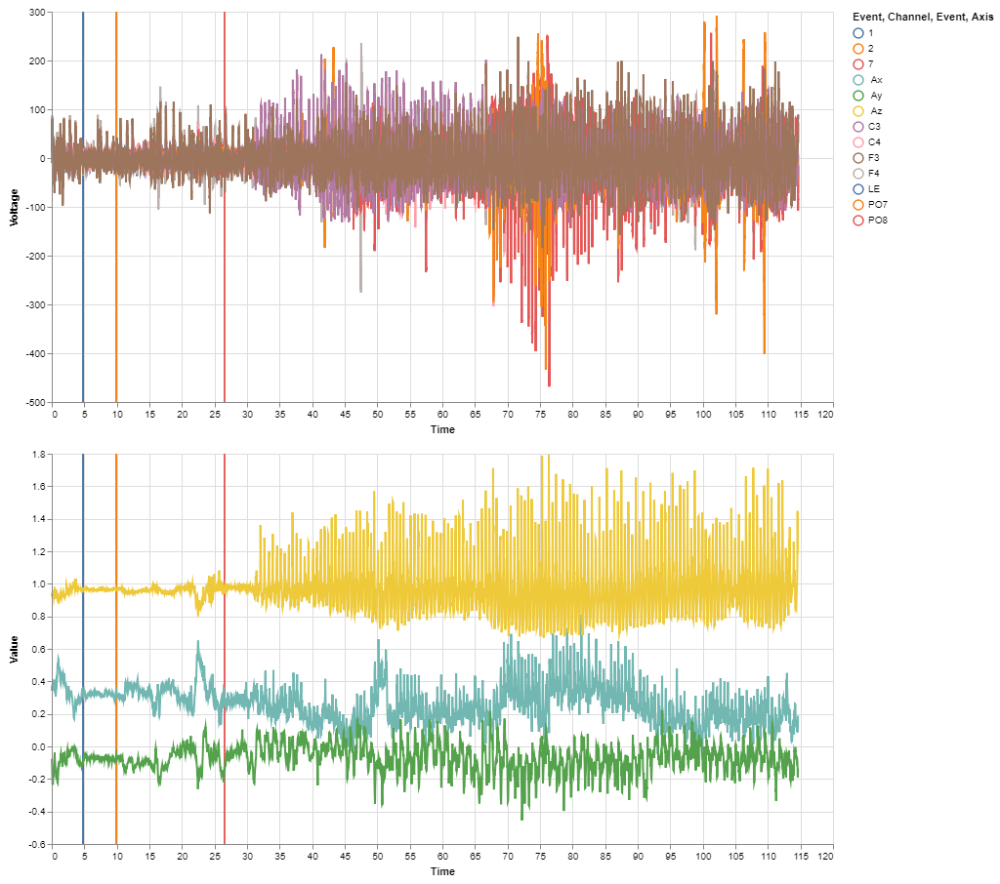

In [28]:
fig & fig_acce